# Analysis Graz supermarkets

In [11]:
import plotly.io as pio
pio.renderers.default = "iframe"

In [1]:
import osmnx as ox
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.neighbors import NearestNeighbors
import plotly.express as px
import ipywidgets
from scipy.spatial import ConvexHull
from shapely.geometry import Polygon, Point

In [4]:
# Load Data
graz = gpd.read_file("graz.shp")
buildings = gpd.read_parquet("buildings.parquet")
supermarkets = gpd.read_parquet("supermarkets.parquet")
graz_pop = gpd.read_parquet("graz_pop.parquet")

1. Different Plots (not used for Report)

In [6]:
# Switch data type for visualisation in diskrete classes
buildings["supermarket_index"] = buildings["supermarket_index"].astype(str)

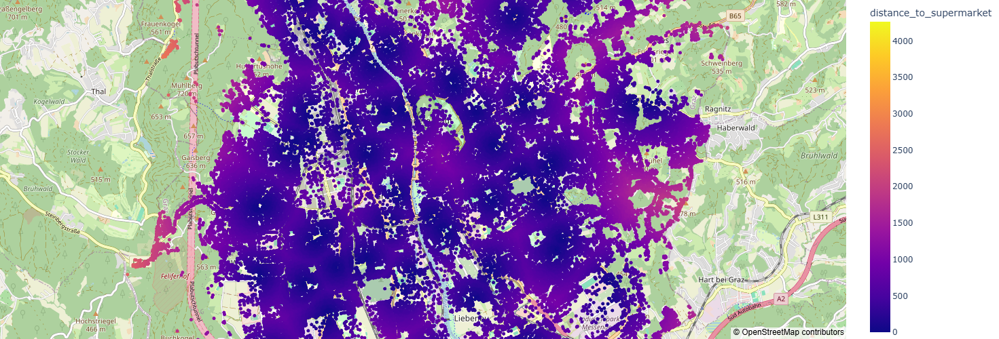

In [18]:
# Plot scattermap of buildings with distance to nearest supermarket
fig = px.scatter_mapbox(buildings, lat="lat_geb", lon="lon_geb", hover_name="brand", hover_data=["distance_to_supermarket"],color="distance_to_supermarket",
                        color_discrete_sequence = px.colors.qualitative.Set3, zoom=12, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

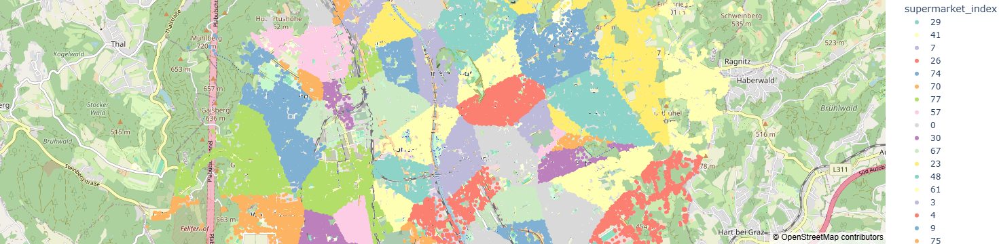

In [28]:
# Plot scattermap of buildings with nearest supermarket index
fig = px.scatter_mapbox(buildings, lat="lat_geb", lon="lon_geb", hover_name="brand",color="supermarket_index",
                        color_discrete_sequence = px.colors.qualitative.Set3, zoom=12, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

2. Convex Hull for supermarkets

In [7]:
grouped = buildings.groupby('supermarket_index')

polygons = []

# Loop for each group (supermarket_index)
for idx, group in grouped:
    points = np.array([(point.x, point.y) for point in group.centroid])
    # Building Convex Hull
    hull = ConvexHull(points)
    # Building polygon out of convex hull output
    polygon_points = np.vstack([points[hull.vertices], points[hull.vertices][0]]) 
    polygon = Polygon(polygon_points)
    
    polygons.append({
        'supermarkt_index': idx,  
        'geometry': polygon      
    })

hull_Graz = gpd.GeoDataFrame(polygons, crs=supermarkets.crs)

# hull_Graz.to_file('konvexe_huellen.shp')

/tmp/ipykernel_119/546134688.py:10: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  points = np.array([(point.x, point.y) for point in group.centroid])
/tmp/ipykernel_119/546134688.py:29: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  hull_Graz.to_file('konvexe_huellen.shp')


3. supermarkets convex hull join to population of Graz

In [ ]:
# hull_Graz = gpd.read_file("konvexe_huellen.shp")
# join population of Graz and convex hull building points
hull_pop = graz_pop.sjoin(hull_Graz, how="right")

hull_pop = hull_pop.dropna()
hull_pop = hull_pop.drop(columns=["index_left"])
# group by supermarket for population data
gruppiert = hull_pop.groupby('supermarkt_index').agg({
    'value': 'sum',
    'geometry': 'first'
}).reset_index()

gruppiert = gpd.GeoDataFrame(gruppiert, geometry='geometry')
gruppiert.set_crs(hull_pop.crs, allow_override=True, inplace=True)

4. Plotting catchment area  of supermarkets in Graz with population data

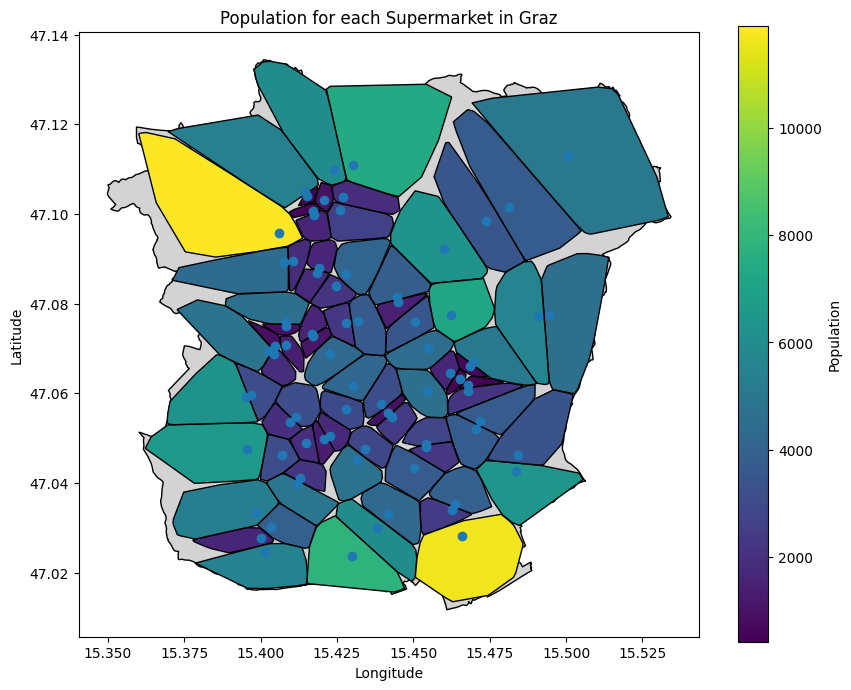

In [20]:
fig, ax = plt.subplots(figsize=(10, 10))

graz.plot(ax=ax, color="lightgray", edgecolor="black")

gruppiert.plot(ax=ax, facecolor='red', edgecolor='black', label='Konvexe Hüllen', column = "value", legend=True,legend_kwds={'shrink': 0.8, 'label': "Population"})
supermarkets['centroid'].plot(ax=ax)

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Population for each Supermarket in Graz')

plt.savefig('Graz.png')

plt.show()